# Team
- Stefanos Panteli UC1065916<br>
spante01@ucy.ac.cy

- Evangelia Krigkou UC1067400<br>
ekrigk01@ucy.ac.cy

- Rafael Chrysanthou UC1064747<br>
rchrys03@ucy.ac.cy


GitHub: [https://github.com/stefanosPanteli/EPL445](https://github.com/stefanosPanteli/EPL445)

# Installs

In [1]:
!pip install opencv-python
!pip install matplotlib

# Imports

In [2]:
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from typing import Literal
import os

# Create the images folder for the output files.
if not os.path.exists('images'):
  os.makedirs('images')

# Functions & Constants

In [3]:
# A function to turn an image into a chromatic tone
def get_chromatic_tone(image: cv2.Mat, colour: Literal['r', 'g', 'b']) -> cv2.Mat:
  '''
  `get_chromatic_tone` turns an image into a chromatic tone chosen as an argument
  Basically for red:
  ```python
  _, _, r = cv2.split(img)
  img_cpy = img.copy()
  img_cpy[:,:,0] = img_cpy[:,:,1] = 0
  return cv2.merge((img_cpy, img_cpy, r))
  ```

  Args:
    image (cv2.Mat): The image to turn into a chromatic tone
    colour (Literal['r', 'g', 'b']): The colour to turn into a chromatic tone

  Returns:
    cv2.Mat: The image with the wanted chromatic tone

  Raises:
    Exception: If the colour is not valid
  '''
  # Copy and split
  img_cpy = image.copy()
  b, g, r = cv2.split(img_cpy)

  # For the blue tone
  if colour == 'b':
    # Zero out green and red
    img_cpy[:,:,1] = img_cpy[:,:,2] = 0
    return cv2.merge((b, img_cpy[:,:,1], img_cpy[:,:,2]))

  elif colour == 'g':
    # Zero out blue and red
    img_cpy[:,:,0] = img_cpy[:,:,2] = 0
    return cv2.merge((img_cpy[:,:,0], g, img_cpy[:,:,2]))

  elif colour == 'r':
    # Zero out blue and green
    img_cpy[:,:,0] = img_cpy[:,:,1] = 0
    return cv2.merge((img_cpy[:,:,0], img_cpy[:,:,1], r))

  else:
    raise Exception('Invalid colour')

# Section A - Photo

# 1

In [7]:
# Read RGB color image
img = cv2.imread('input/image.jpg')
# Read grayscale image
img_gray = cv2.imread('input/image.jpg', 0)

if img is None or img_gray is None:
  print('Error reading image')

# 2

RGB image


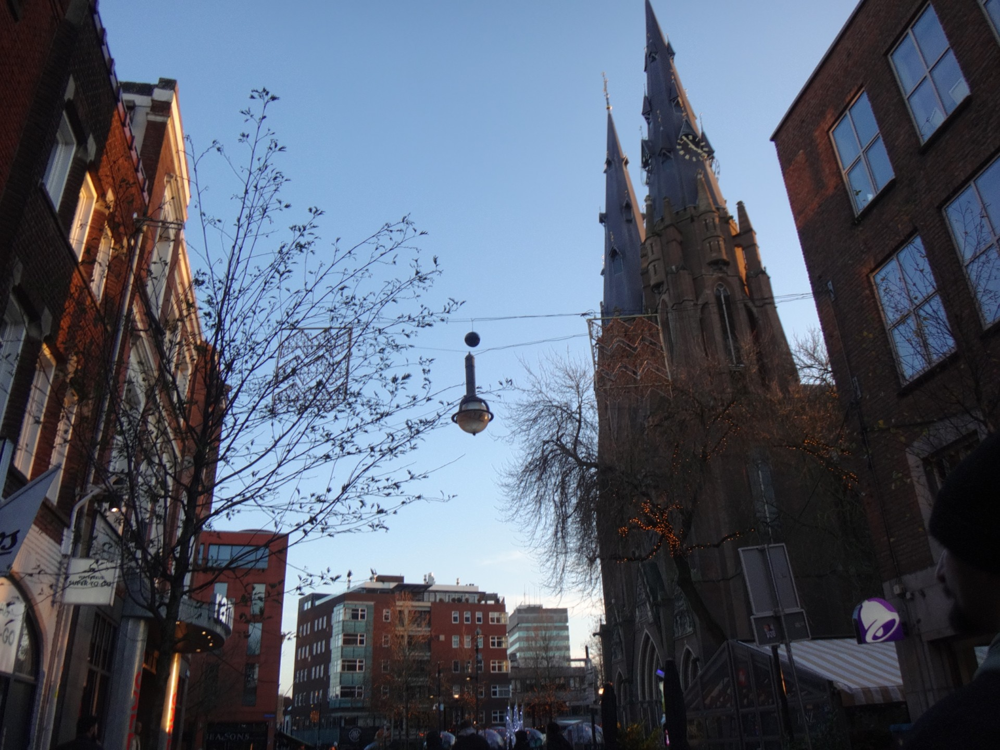

Grayscale image


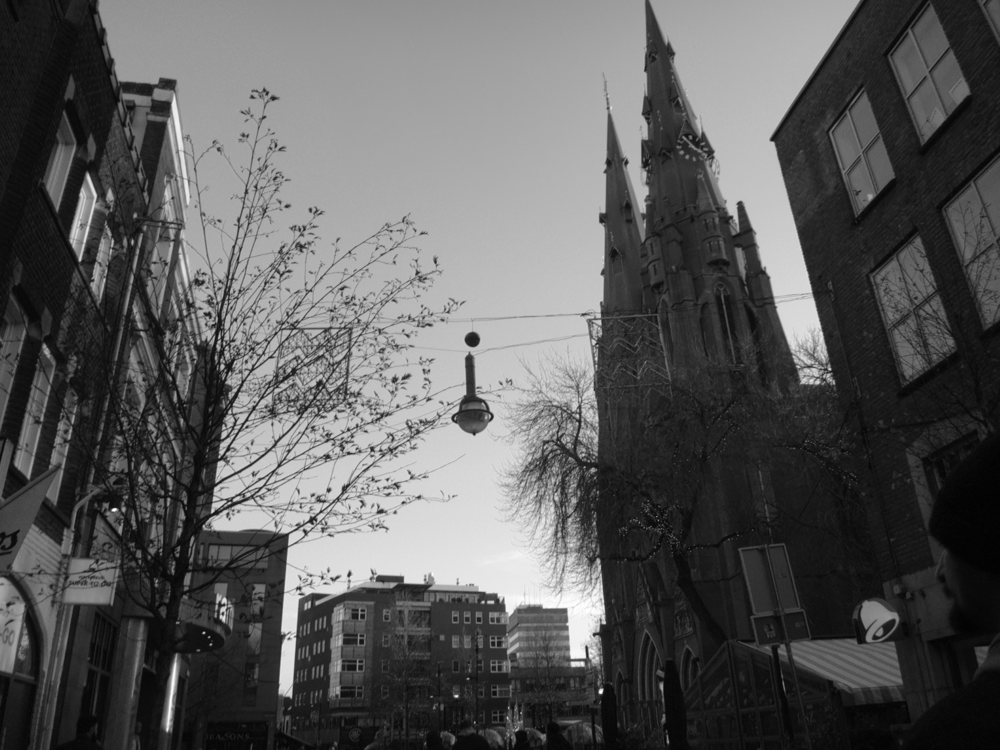

In [8]:
# Show RGB image
print('RGB image')
cv2_imshow(img)

# Show grayscale image
print('Grayscale image')
cv2_imshow(img_gray)

# 3

Red chromatic tone


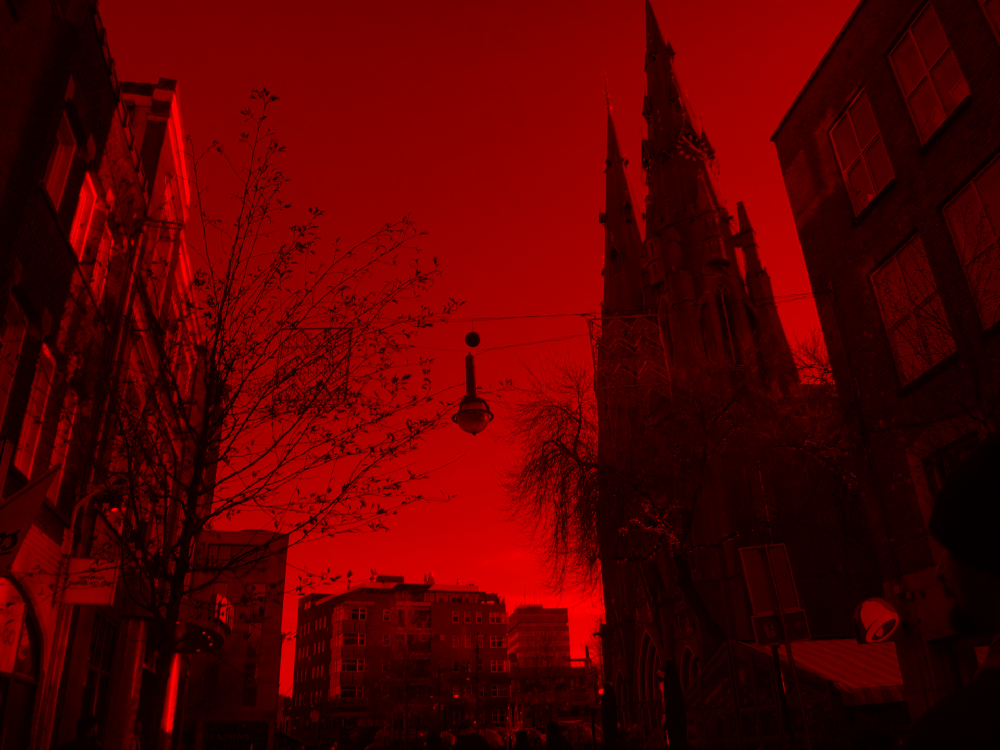

Green chromatic tone


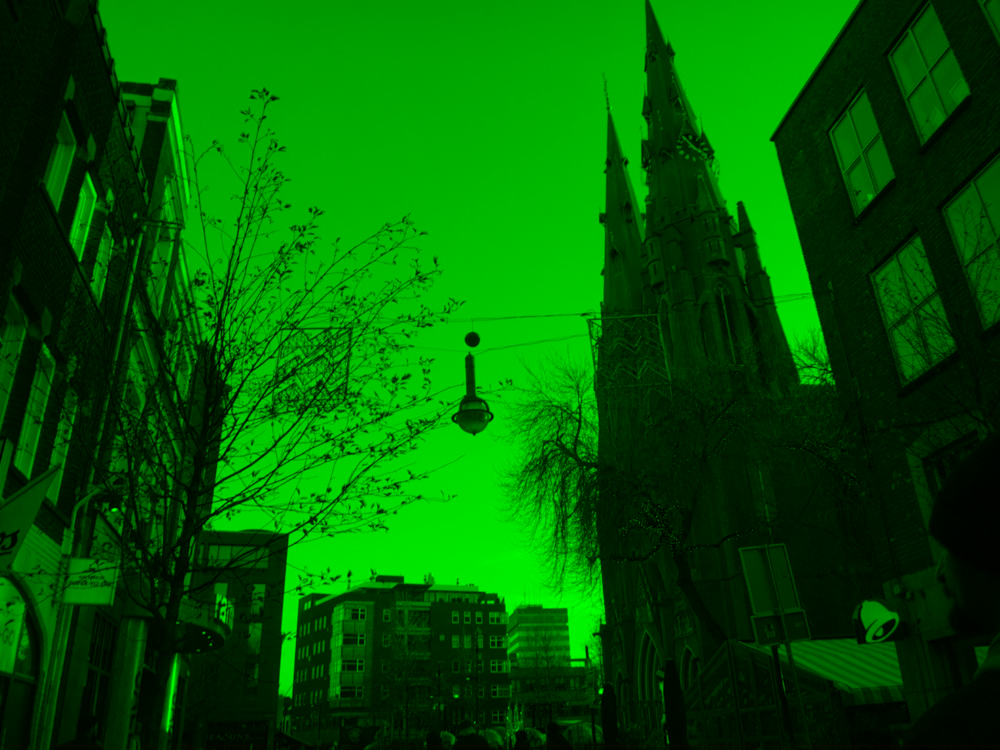

Blue chromatic tone


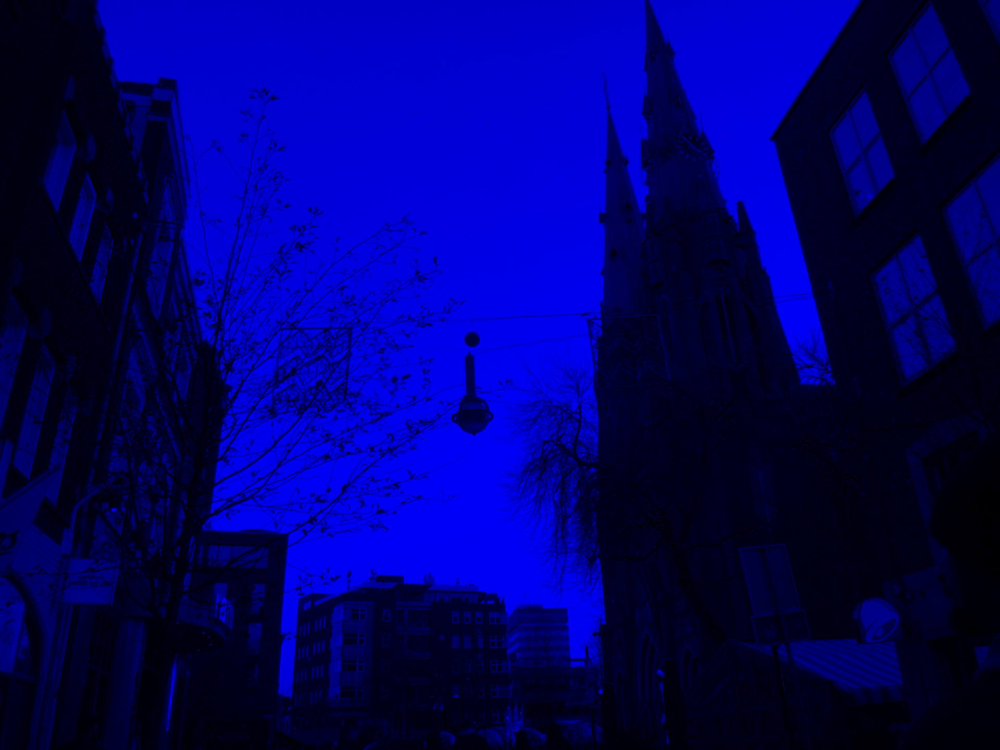

In [9]:
# Get the chromatic tones
red_chromatic_tone = get_chromatic_tone(img, 'r')
green_chromatic_tone = get_chromatic_tone(img, 'g')
blue_chromatic_tone = get_chromatic_tone(img, 'b')

# Show the chromatic tones
print('Red chromatic tone')
cv2_imshow(red_chromatic_tone)
print('Green chromatic tone')
cv2_imshow(green_chromatic_tone)
print('Blue chromatic tone')
cv2_imshow(blue_chromatic_tone)

# 4

In [10]:
# Save the chromatic tones
cv2.imwrite('images/red_chromatic_tone_image.jpg', red_chromatic_tone)
cv2.imwrite('images/green_chromatic_tone_image.tiff', green_chromatic_tone)
cv2.imwrite('images/blue_chromatic_tone_image.png', blue_chromatic_tone)

True

# 5

Luminance


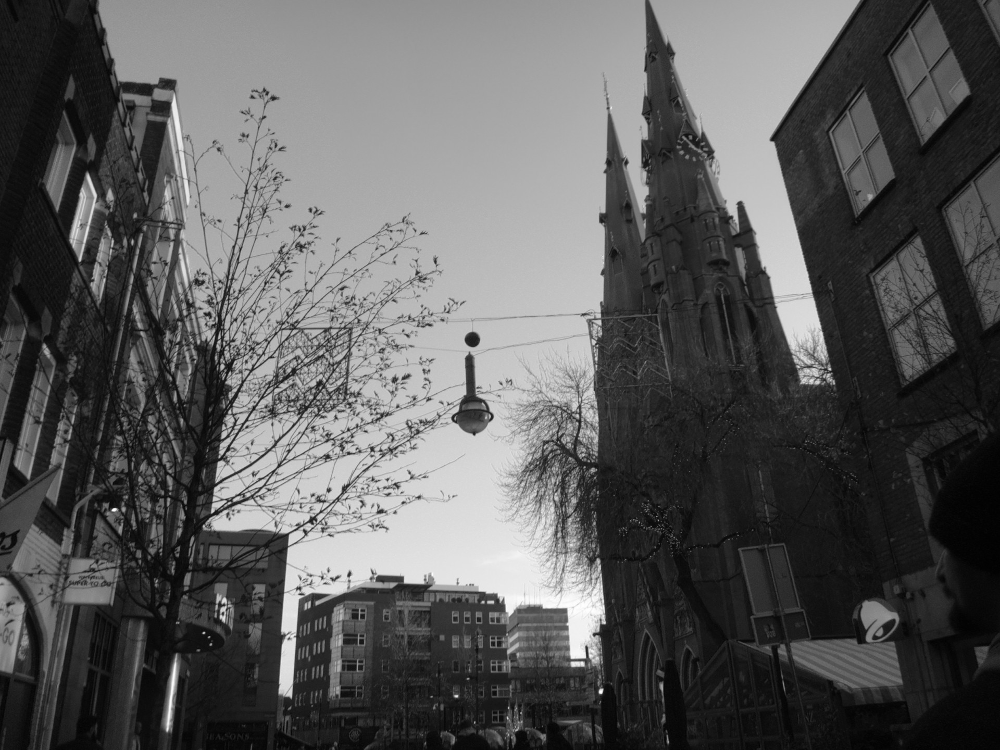

Chroma Red


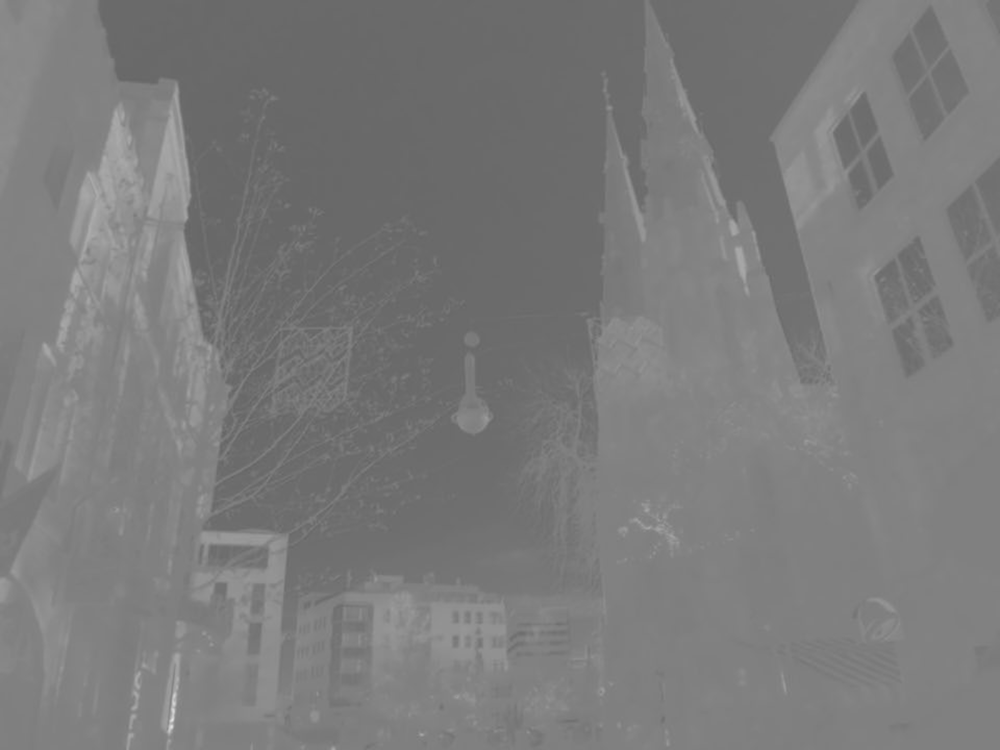

Chroma Blue


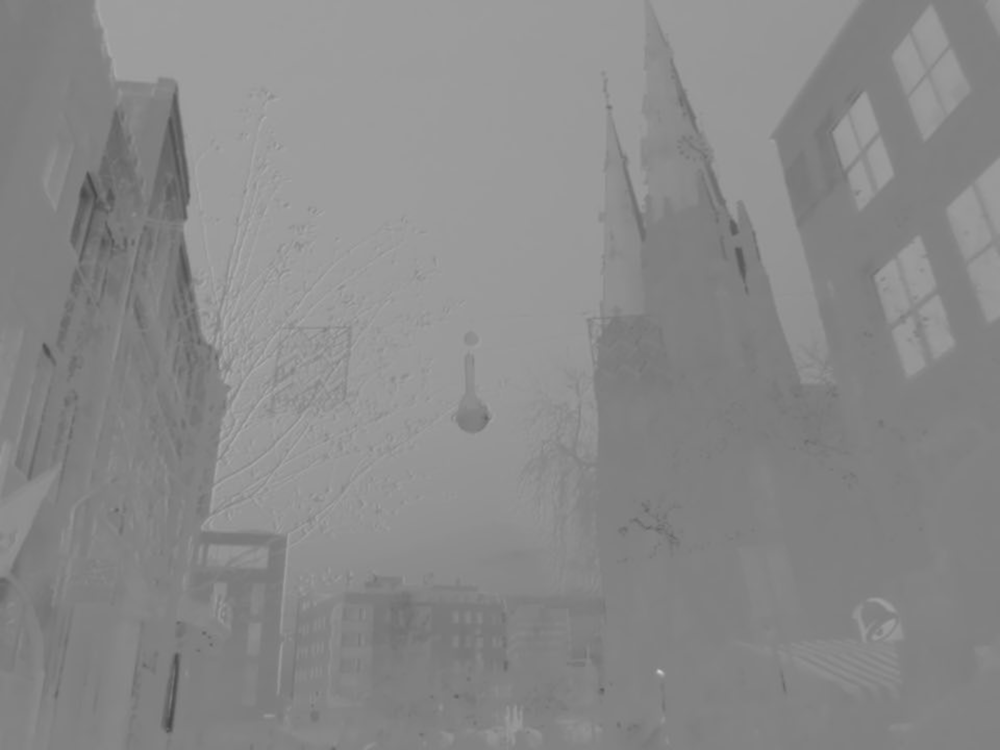

In [11]:
# Convert the RGB image to YCrCb
ycrcb_image = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
# Split it into Y, Cr, Cb
Y, Cr, Cb = cv2.split(ycrcb_image)

# Show the Y, Cr, Cb
print('Luminance')
cv2_imshow(Y)
print('Chroma Red')
cv2_imshow(Cr)
print('Chroma Blue')
cv2_imshow(Cb)

# 6

Histogram Grayscale


/tmp/ipython-input-3847903951.py:3: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(img_gray.ravel(),256,[0,256], color='gray')


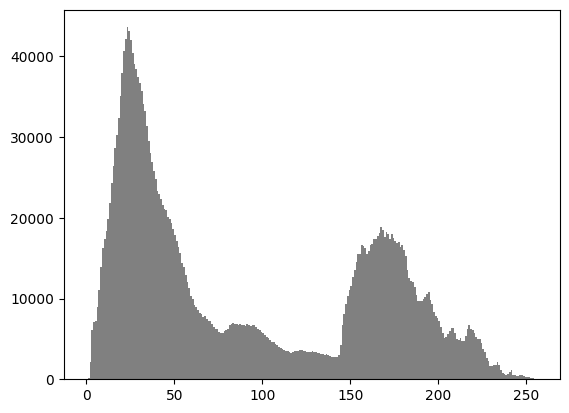

In [12]:
# Show the histograms
print('Histogram Grayscale')
plt.hist(img_gray.ravel(),256,[0,256], color='gray')
plt.show()

In [13]:
# Split the RGB image
b, g, r = cv2.split(img)

Histogram Red


/tmp/ipython-input-4031333532.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(r.ravel(),256,[0,256], color='red')


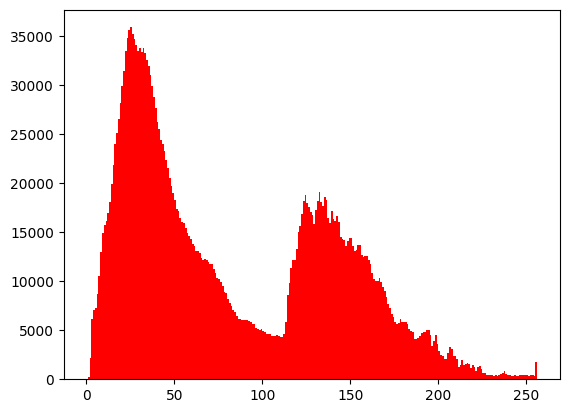

In [14]:
print('Histogram Red')
plt.hist(r.ravel(),256,[0,256], color='red')
plt.show()

Histogram Green


/tmp/ipython-input-3035958737.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(g.ravel(),256,[0,256], color='green')


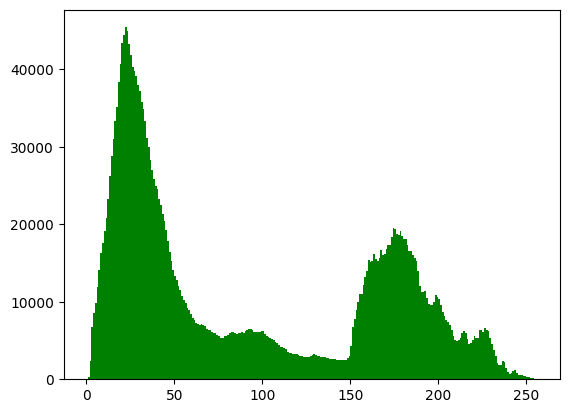

In [15]:
print('Histogram Green')
plt.hist(g.ravel(),256,[0,256], color='green')
plt.show()

Histogram Blue


/tmp/ipython-input-1000130848.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(b.ravel(),256,[0,256], color='blue')


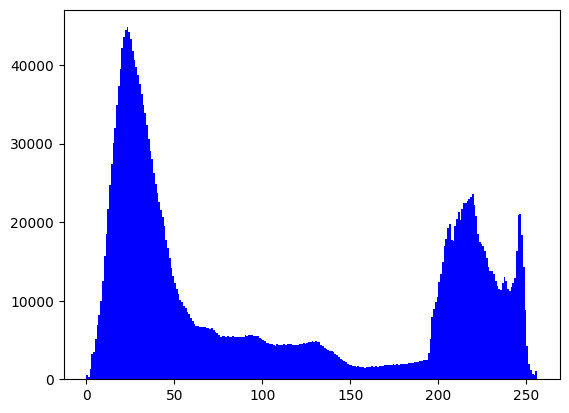

In [16]:
print('Histogram Blue')
plt.hist(b.ravel(),256,[0,256], color='blue')
plt.show()

# Section B - Video

# Capture a Single Frame

In [20]:
# Get the video
cam = cv2.VideoCapture('input/video.MOV')

frame_no = 150 # Frame number
cam.set(cv2.CAP_PROP_POS_FRAMES, frame_no)

# Retrieve the frame
ret, frame = cam.read()
if ret:
    cv2.imwrite('input/frame.jpg', frame)
    print('saved input/frame.jpg')
else:
    print('could not read that frame')

cam.release()


saved input/frame.jpg


# 1

In [21]:
# Read RGB color frame
frame = cv2.imread('input/frame.jpg')
# Read grayscale frame
frame_gray = cv2.imread('input/frame.jpg', 0)

if frame is None or frame_gray is None :
  print('Error reading frame')

# 2

RGB frame


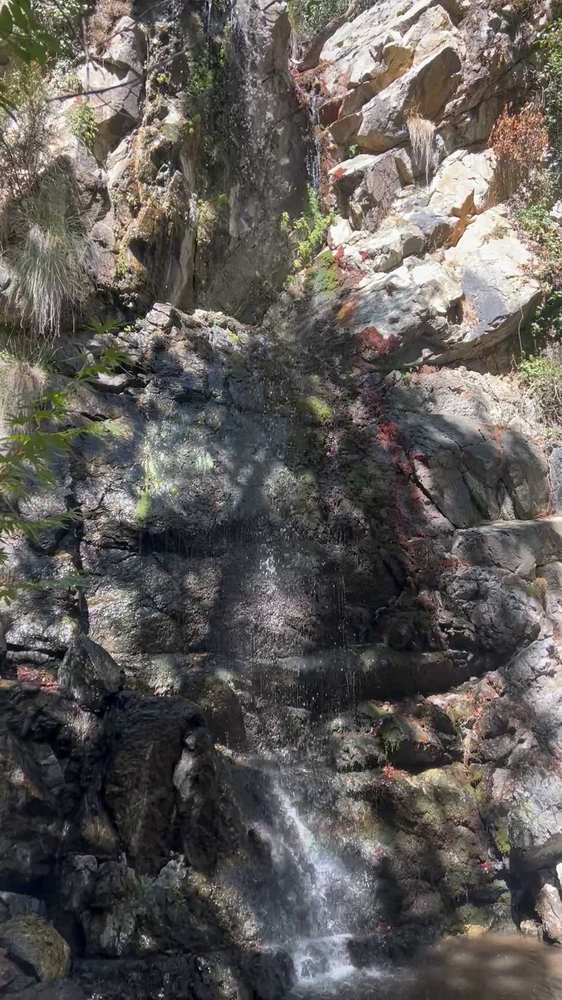

Grayscale frame


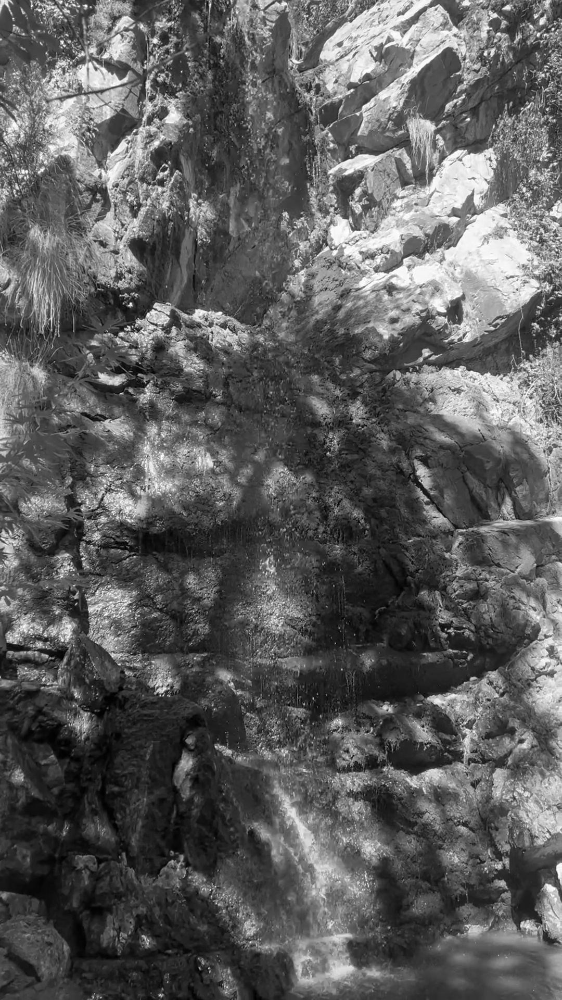

In [22]:
# Show RGB frame
print('RGB frame')
cv2_imshow(frame)

# Show grayscale frame
print('Grayscale frame')
cv2_imshow(frame_gray)

# 3

Red chromatic frame tone


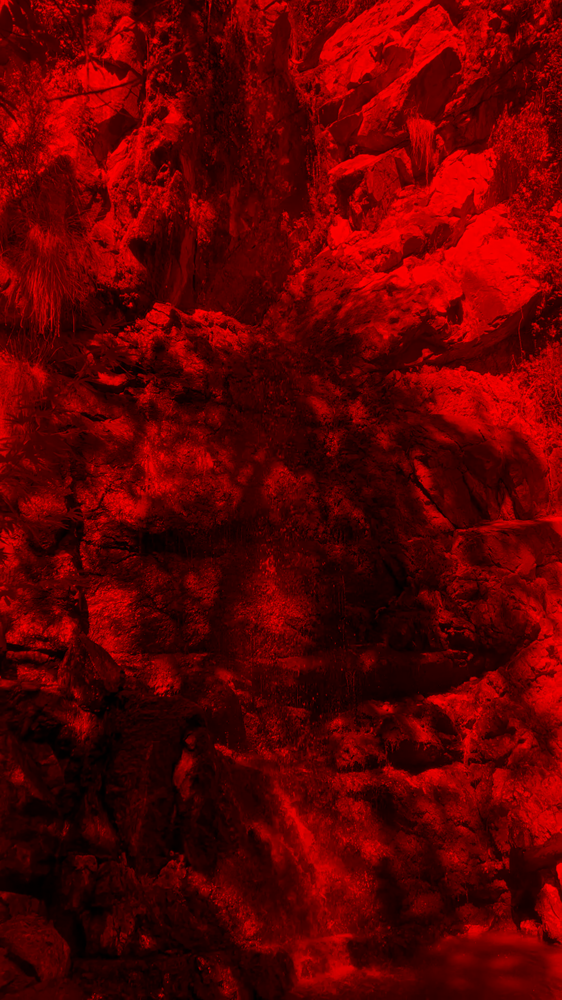

Green chromatic frame tone


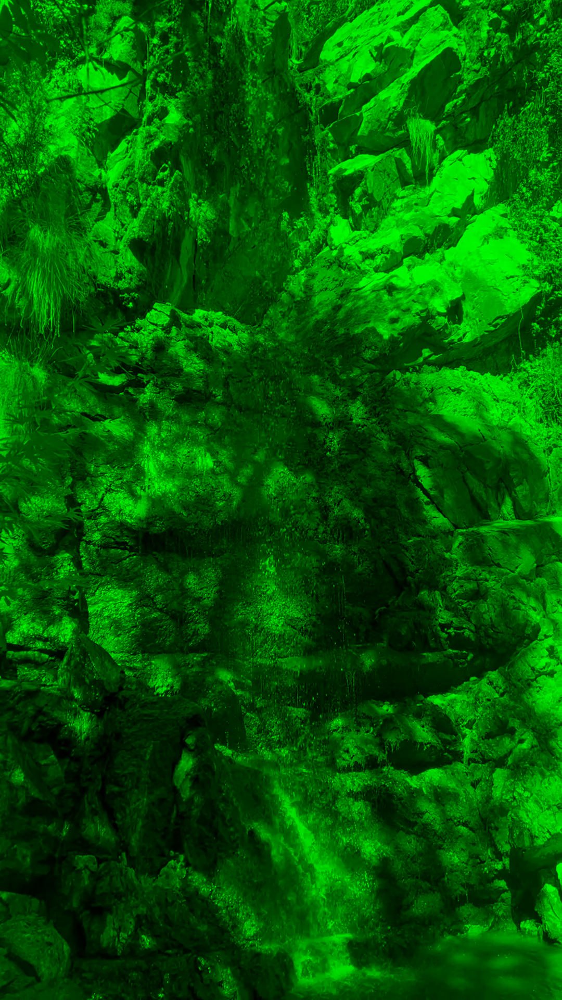

Blue chromatic frame tone


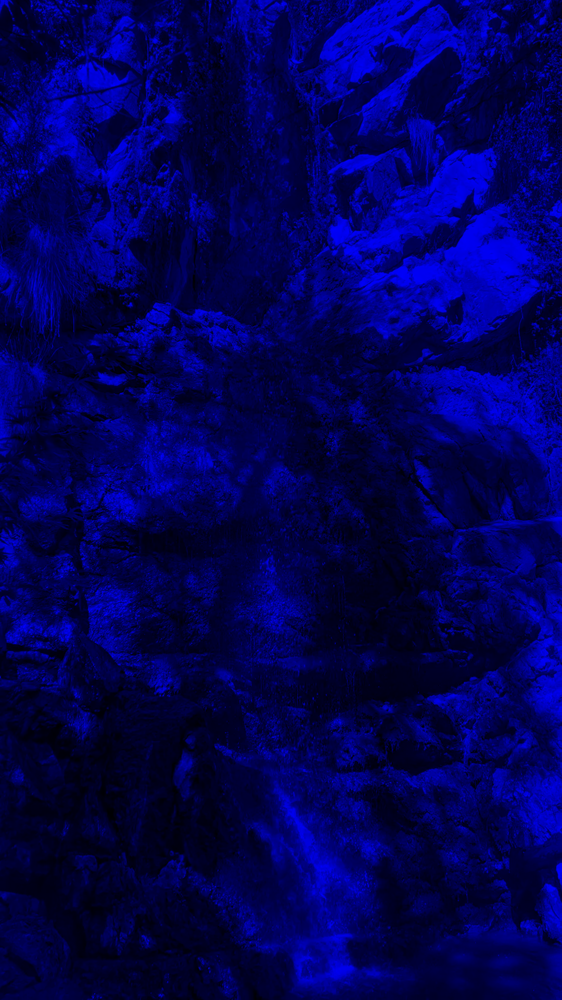

In [23]:
# Get the chromatic tones
red_chromatic_tone_frame = get_chromatic_tone(frame, 'r')
green_chromatic_tone_frame = get_chromatic_tone(frame, 'g')
blue_chromatic_tone_frame = get_chromatic_tone(frame, 'b')

print('Red chromatic frame tone')
cv2_imshow(red_chromatic_tone_frame)
print('Green chromatic frame tone')
cv2_imshow(green_chromatic_tone_frame)
print('Blue chromatic frame tone')
cv2_imshow(blue_chromatic_tone_frame)

# 4

In [24]:
# Save the chromatic tones
cv2.imwrite('images/red_chromatic_tone_frame.jpg', red_chromatic_tone_frame)
cv2.imwrite('images/green_chromatic_tone_frame.tiff', green_chromatic_tone_frame)
cv2.imwrite('images/blue_chromatic_tone_frame.png', blue_chromatic_tone_frame)

True

# 5

Luminance


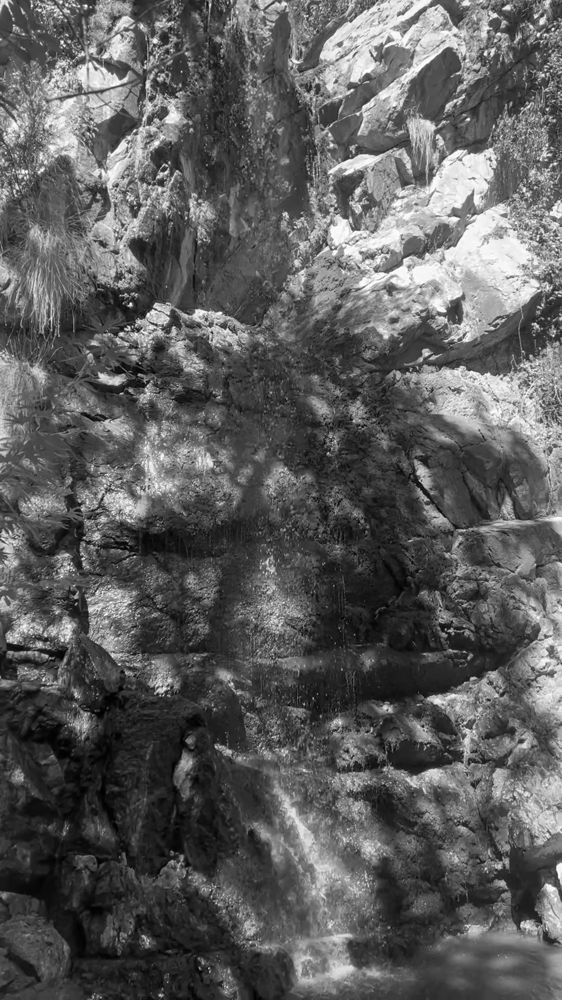

Chroma Red


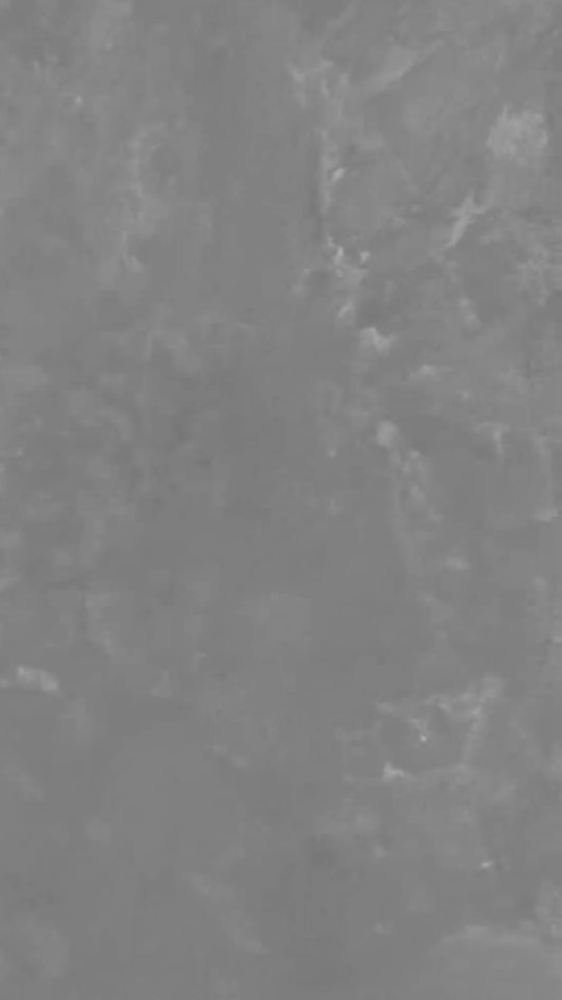

Chroma Blue


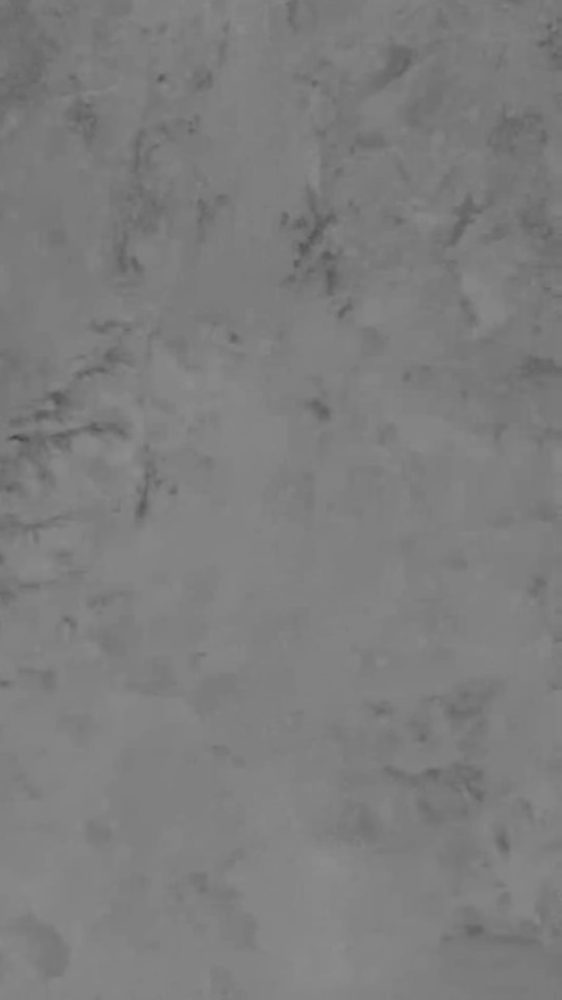

In [25]:
# Convert the RGB frame to YCrCb
ycrcb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2YCrCb)
# Split it into Y, Cr, Cb
Y, Cr, Cb = cv2.split(ycrcb_frame)

# Show the Y, Cr, Cb
print('Luminance')
cv2_imshow(Y)
print('Chroma Red')
cv2_imshow(Cr)
print('Chroma Blue')
cv2_imshow(Cb)

# 6

Histogram Grayscale


/tmp/ipython-input-1470094686.py:3: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(frame_gray.ravel(),256,[0,256], color='gray')


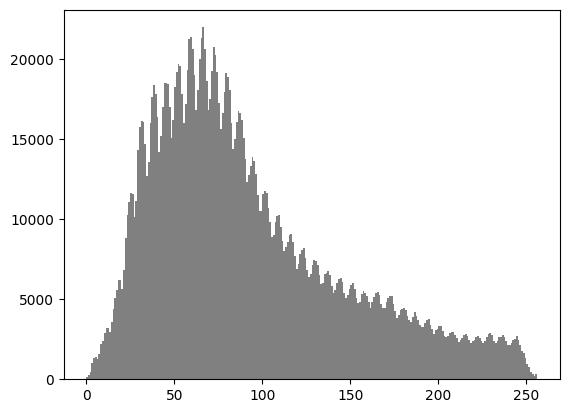

In [26]:
# Show the histograms
print('Histogram Grayscale')
plt.hist(frame_gray.ravel(),256,[0,256], color='gray')
plt.show()

In [27]:
# Split the RGB frame
b, g, r = cv2.split(frame)

Histogram Red


/tmp/ipython-input-4031333532.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(r.ravel(),256,[0,256], color='red')


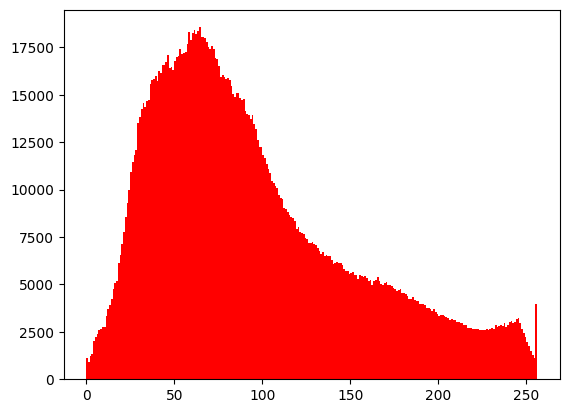

In [28]:
print('Histogram Red')
plt.hist(r.ravel(),256,[0,256], color='red')
plt.show()

Histogram Green


/tmp/ipython-input-3035958737.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(g.ravel(),256,[0,256], color='green')


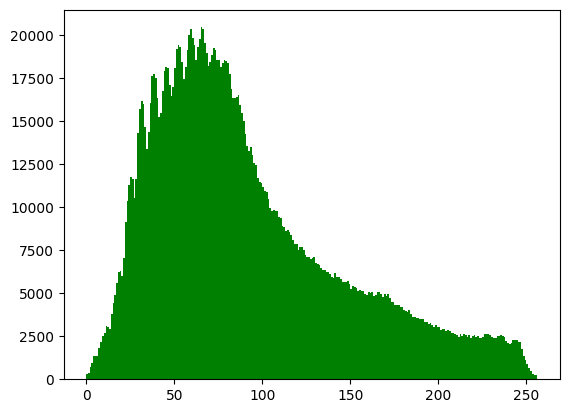

In [29]:
print('Histogram Green')
plt.hist(g.ravel(),256,[0,256], color='green')
plt.show()

Histogram Blue


/tmp/ipython-input-1000130848.py:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(b.ravel(),256,[0,256], color='blue')


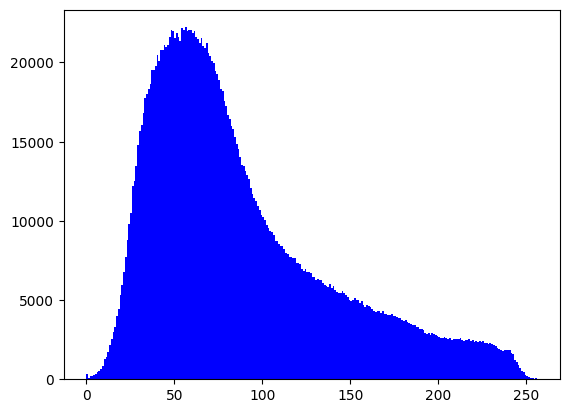

In [30]:
print('Histogram Blue')
plt.hist(b.ravel(),256,[0,256], color='blue')
plt.show()